# 1. Check for Cuda Availability

In [1]:
from pathlib import Path
import random
import os
import shutil

In [2]:
!nvidia-smi

Sat Mar 29 14:00:39 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   64C    P8             11W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# 2.&nbsp;Upload Image Dataset and Prepare Training Data

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

!cp "/content/gdrive/MyDrive/Colab Notebooks/Spark/data.zip" /content

Mounted at /content/gdrive


## 2.1 Split images into train and validation folders

In [4]:
# Unzip images to a custom data folder
!unzip -q /content/data.zip -d /content/custom_data

In [6]:
# Change this path to match your Google Drive dataset location
data_path = "/content/custom_data/data"

# Percentage of data for training (e.g., 80%)
train_percent = 0.8
val_percent = 1 - train_percent

# Input dataset paths
input_image_path = os.path.join(data_path, 'images')
input_label_path = os.path.join(data_path, 'labels')

# Output dataset paths (inside Colab's workspace)
train_img_path = "/content/data/train/images"
train_txt_path = "/content/data/train/labels"
val_img_path = "/content/data/validation/images"
val_txt_path = "/content/data/validation/labels"

# Create folders if they don't exist
for dir_path in [train_img_path, train_txt_path, val_img_path, val_txt_path]:
    os.makedirs(dir_path, exist_ok=True)
    print(f'✔ Created folder: {dir_path}')

# ==== Step 3: Get Image & Annotation Files ====
img_file_list = list(Path(input_image_path).rglob('*'))
txt_file_list = list(Path(input_label_path).rglob('*'))

print(f'📸 Total Images: {len(img_file_list)}')
print(f'📝 Total Annotations: {len(txt_file_list)}')

# Determine number of files to move
file_num = len(img_file_list)
train_num = int(file_num * train_percent)
val_num = file_num - train_num

print(f'✅ Moving {train_num} images to TRAIN folder')
print(f'✅ Moving {val_num} images to VALIDATION folder')

# ==== Step 4: Split Data Randomly ====
for i, set_num in enumerate([train_num, val_num]):
    for _ in range(set_num):
        img_path = random.choice(img_file_list)
        img_fn = img_path.name
        base_fn = img_path.stem
        txt_fn = base_fn + '.txt'
        txt_path = os.path.join(input_label_path, txt_fn)

        # Determine output folder
        if i == 0:
            new_img_path, new_txt_path = train_img_path, train_txt_path
        else:
            new_img_path, new_txt_path = val_img_path, val_txt_path

        # Copy image
        shutil.copy(img_path, os.path.join(new_img_path, img_fn))

        # Copy annotation file (if it exists)
        if os.path.exists(txt_path):
            shutil.copy(txt_path, os.path.join(new_txt_path, txt_fn))

        # Remove from the list
        img_file_list.remove(img_path)

print("✅ Data splitting completed successfully!")


✔ Created folder: /content/data/train/images
✔ Created folder: /content/data/train/labels
✔ Created folder: /content/data/validation/images
✔ Created folder: /content/data/validation/labels
📸 Total Images: 85
📝 Total Annotations: 85
✅ Moving 68 images to TRAIN folder
✅ Moving 17 images to VALIDATION folder
✅ Data splitting completed successfully!


In [7]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.0/950.0 kB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 60.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 34.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 46.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 52.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

# 3.&nbsp;Configure Training


In [8]:
# Python function to automatically create data.yaml config file
# 1. Reads "classes.txt" file to get list of class names
# 2. Creates data dictionary with correct paths to folders, number of classes, and names of classes
# 3. Writes data in YAML format to data.yaml

import yaml
import os

def create_data_yaml(path_to_classes_txt, path_to_data_yaml):

  # Read class.txt to get class names
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found! Please create a classes.txt labelmap and move it to {path_to_classes_txt}')
    return
  with open(path_to_classes_txt, 'r') as f:
    classes = []
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
  number_of_classes = len(classes)

  # Create data dictionary
  data = {
      'path': '/content/data',
      'train': 'train/images',
      'val': 'validation/images',
      'nc': number_of_classes,
      'names': classes
  }

  # Write data to YAML file
  with open(path_to_data_yaml, 'w') as f:
    yaml.dump(data, f, sort_keys=False)
  print(f'Created config file at {path_to_data_yaml}')

  return

# Define path to classes.txt and run function
path_to_classes_txt = '/content/custom_data/data/classes.txt'
path_to_data_yaml = '/content/data.yaml'

create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('\nFile contents:\n')
!cat /content/data.yaml

Created config file at /content/data.yaml

File contents:

path: /content/data
train: train/images
val: validation/images
nc: 5
names:
- Lizard
- Paper
- Rock
- Scissor
- Spock


# 4.&nbsp;Train Model

## 4.1 Run Training

In [9]:
!yolo detect train data=/content/data.yaml model=yolo11s.pt epochs=60 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 18.4M/18.4M [00:00<00:00, 181MB/s]
Ultralytics 8.3.98 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=Fal

#5.&nbsp;Test Model

In [10]:
!yolo detect predict model=runs/detect/train/weights/best.pt source=data/validation/images save=True

Ultralytics 8.3.98 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,414,735 parameters, 0 gradients, 21.3 GFLOPs

image 1/17 /content/data/validation/images/0005d3ed-20250329_014915.jpg: 640x480 1 Paper, 58.5ms
image 2/17 /content/data/validation/images/16f0f414-20250329_015302.jpg: 640x480 1 Spock, 12.4ms
image 3/17 /content/data/validation/images/413d318c-20250329_014859.jpg: 640x480 1 Paper, 12.4ms
image 4/17 /content/data/validation/images/5326b0d0-20250329_014906.jpg: 640x480 1 Paper, 12.4ms
image 5/17 /content/data/validation/images/53615fed-20250329_015102.jpg: 640x480 1 Scissor, 12.4ms
image 6/17 /content/data/validation/images/5daac9af-20250329_015322.jpg: 640x480 1 Spock, 12.4ms
image 7/17 /content/data/validation/images/66f66b2e-20250329_015226.jpg: 640x480 1 Lizard, 12.4ms
image 8/17 /content/data/validation/images/7eb706f4-20250329_015318.jpg: 640x480 1 Spock, 12.4ms
image 9/17 /content/data/validation/images/81a62900-20

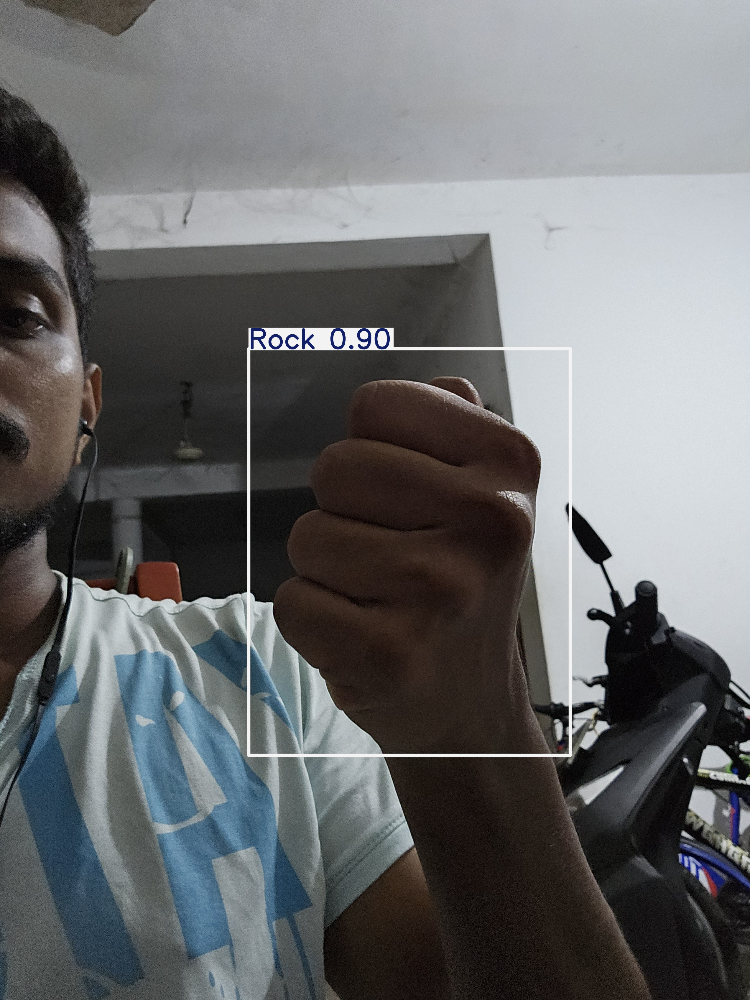

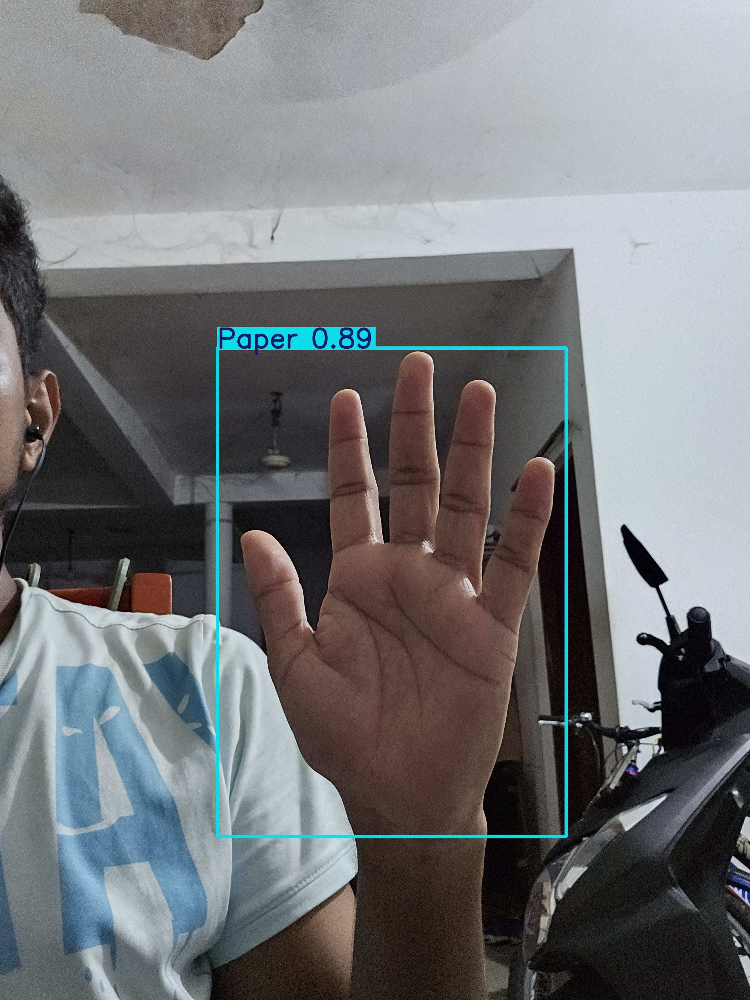

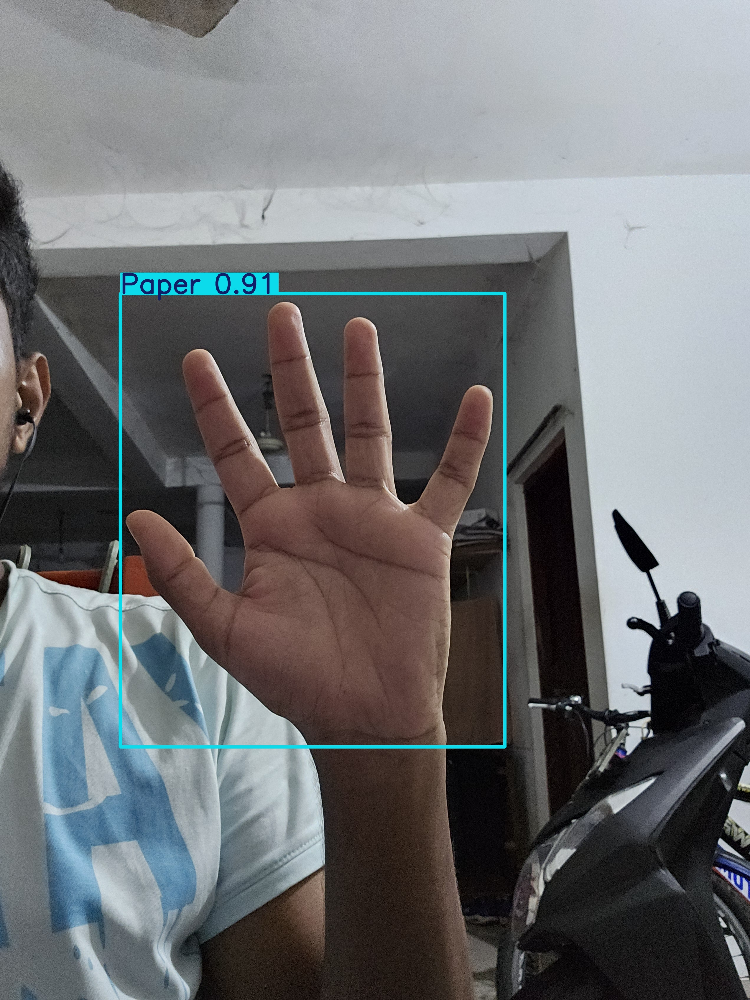

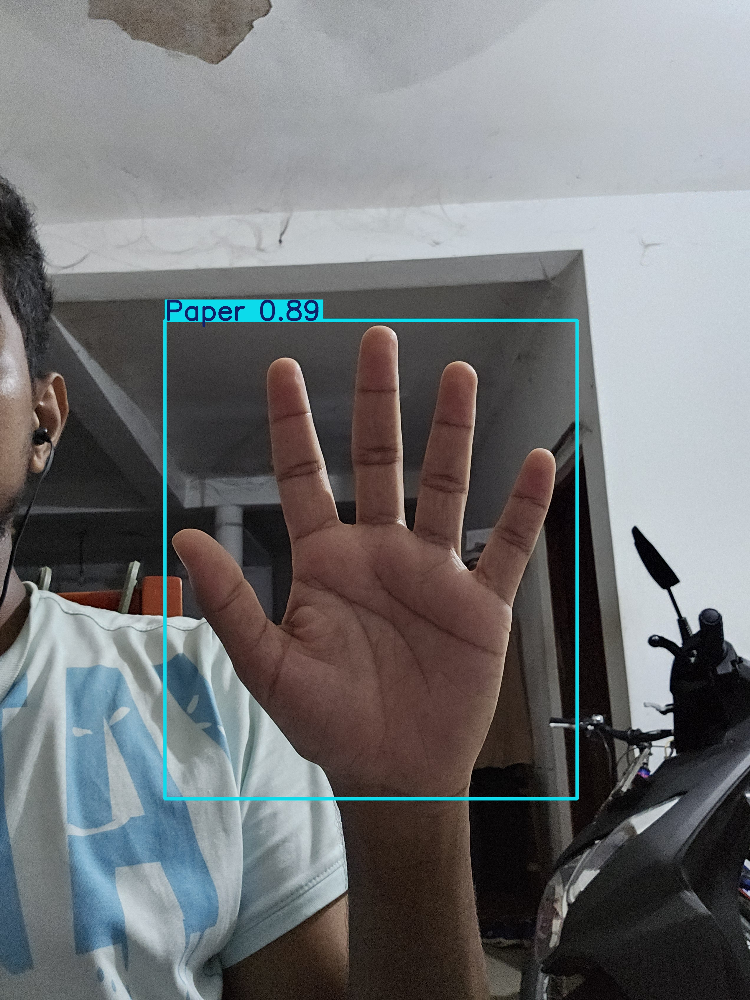

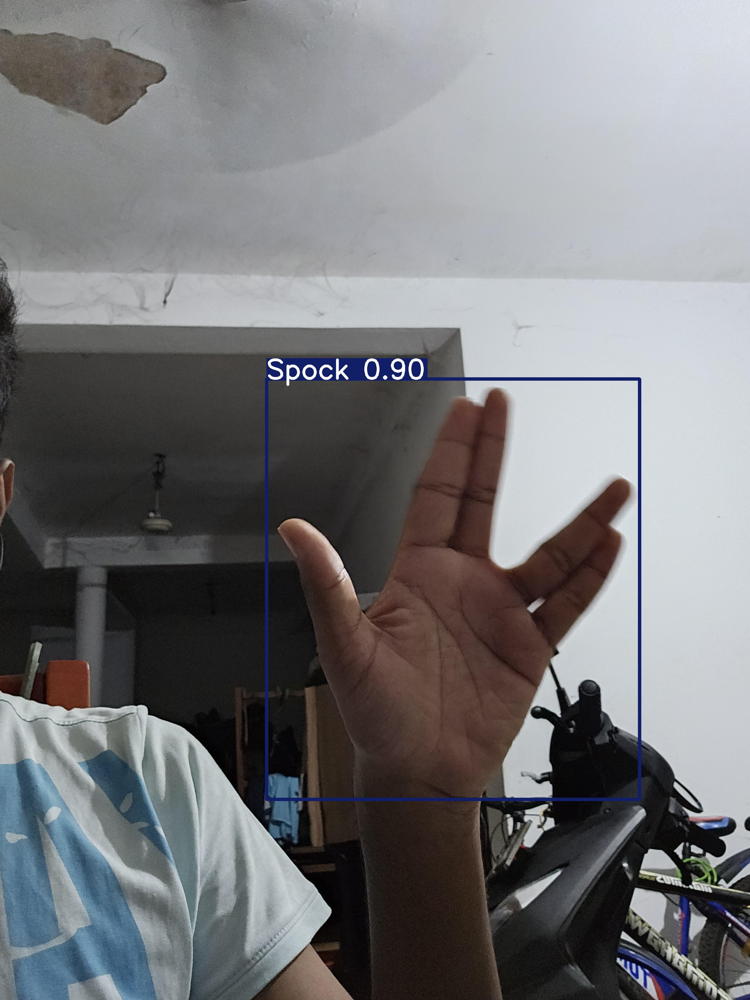

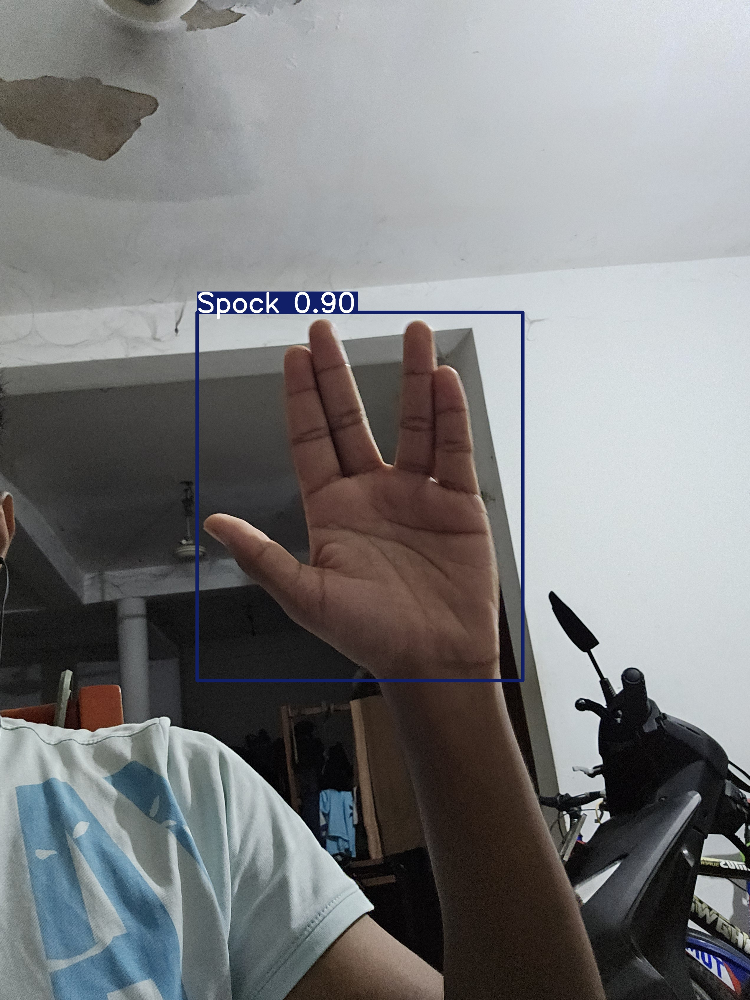

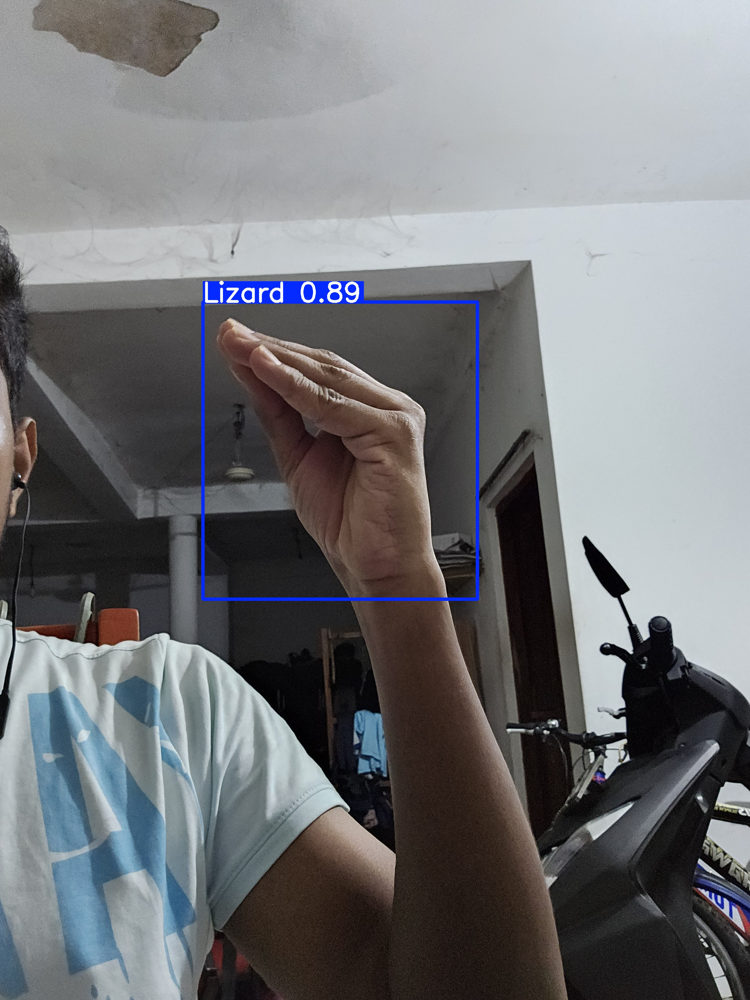

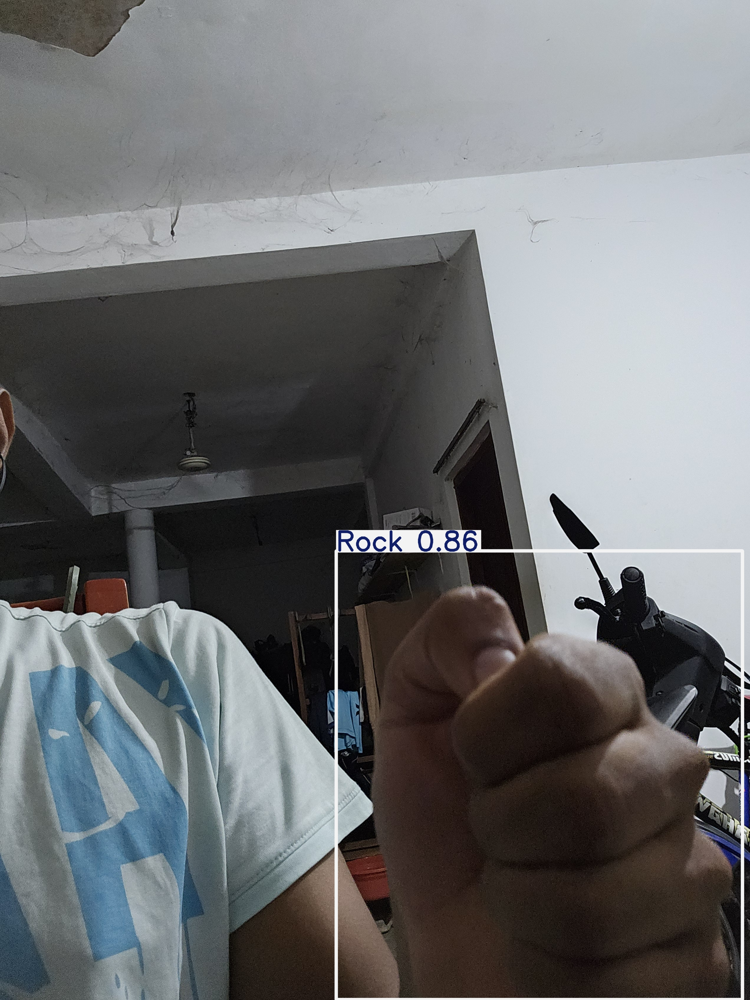

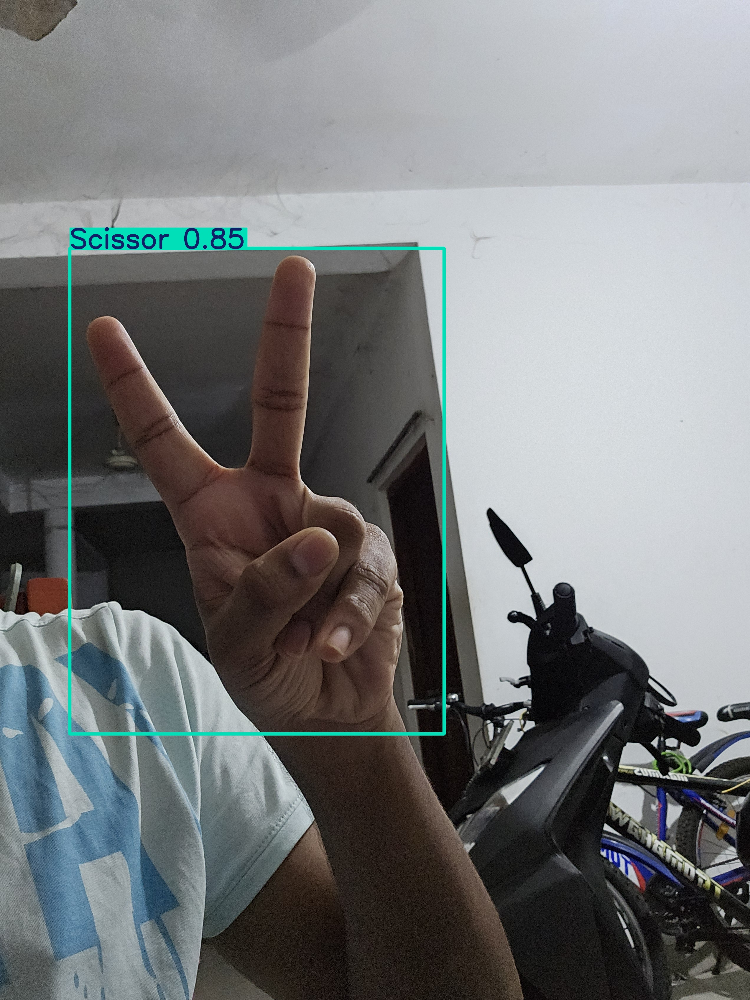

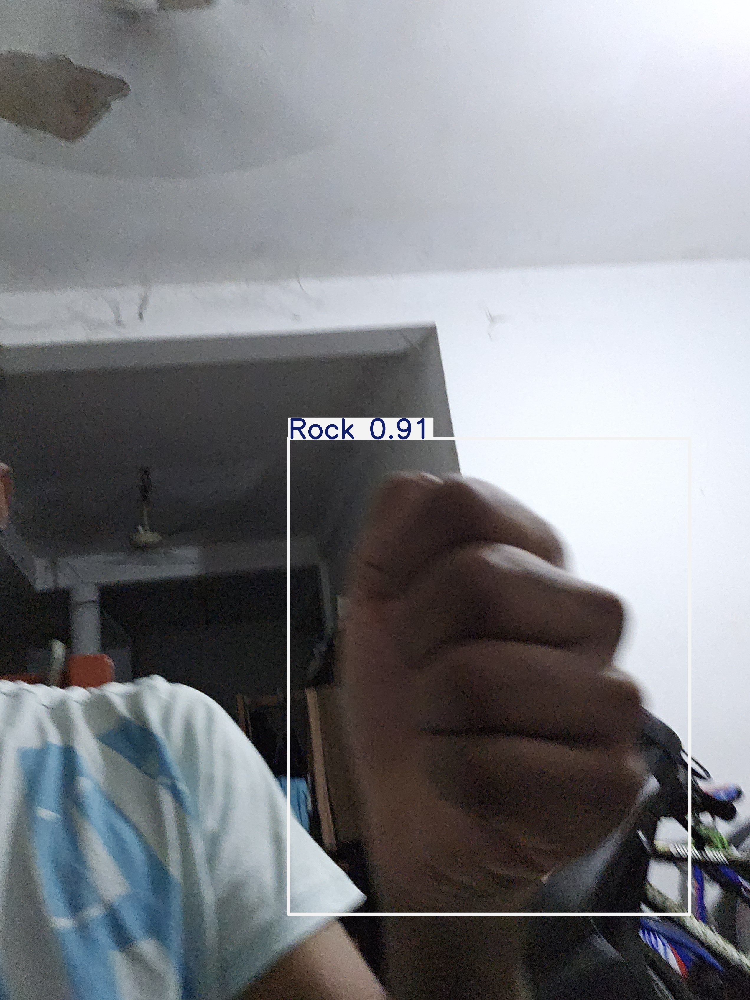

In [11]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')


#6.&nbsp;Deploy Model

In [12]:
# Create "my_model" folder to store model weights and train results
!mkdir /content/my_model
!cp /content/runs/detect/train/weights/best.pt /content/my_model/my_model.pt
!cp -r /content/runs/detect/train /content/my_model

# Zip into "my_model.zip"
%cd my_model
!zip /content/my_model.zip my_model.pt
!zip -r /content/my_model.zip train
%cd /content

/content/my_model
  adding: my_model.pt (deflated 8%)
  adding: train/ (stored 0%)
  adding: train/PR_curve.png (deflated 25%)
  adding: train/events.out.tfevents.1743257002.e6c1409735b1.1196.0 (deflated 91%)
  adding: train/train_batch252.jpg (deflated 11%)
  adding: train/args.yaml (deflated 53%)
  adding: train/train_batch251.jpg (deflated 12%)
  adding: train/train_batch0.jpg (deflated 4%)
  adding: train/weights/ (stored 0%)
  adding: train/weights/last.pt (deflated 8%)
  adding: train/weights/best.pt (deflated 8%)
  adding: train/train_batch250.jpg (deflated 11%)
  adding: train/val_batch0_pred.jpg (deflated 7%)
  adding: train/val_batch0_labels.jpg (deflated 7%)
  adding: train/confusion_matrix.png (deflated 34%)
  adding: train/labels.jpg (deflated 45%)
  adding: train/results.csv (deflated 62%)
  adding: train/F1_curve.png (deflated 11%)
  adding: train/labels_correlogram.jpg (deflated 51%)
  adding: train/train_batch1.jpg (deflated 3%)
  adding: train/confusion_matrix_normali

In [14]:
from google.colab import files

files.download('/content/my_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Now we can use the files in my_model to run real time object detection on raspberry pi using a pi camera or other usb cameras.